In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
!nvidia-smi

Wed Dec  1 10:33:03 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 495.44       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   40C    P0    26W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [3]:
FOLDER = "drive/MyDrive/IIE4123/final/"

In [4]:
!pwd
# !unzip drive/MyDrive/IIE4123/final/train.zip -d "drive/MyDrive/IIE4123/final/train/"
# !unzip drive/MyDrive/IIE4123/final/test.zip -d "drive/MyDrive/IIE4123/final/test/"

/content


In [5]:
import tensorflow as tf
print(tf.__version__)

2.7.0


In [6]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import os, cv2, random, time, shutil, csv
import tensorflow as tf
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from tqdm import tqdm
np.random.seed(42)
%matplotlib inline 

import keras
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Model
from keras.layers import BatchNormalization, Dense, GlobalAveragePooling2D, Lambda, Dropout, InputLayer, Input
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.preprocessing.image import load_img

In [7]:
import gc
import skimage.io

Global Variables (constant value)

In [8]:
#Data path
train_dir = 'drive/MyDrive/IIE4123/final/train'
test_dir = 'drive/MyDrive/IIE4123/final/test'

In [9]:
# train_size = len(os.listdir(train_dir))
# test_size = len(os.listdir(test_dir))
# print(train_size,test_size)

In [10]:
def get_num_files(path):
    if not os.path.exists(path):
        return 0
    return sum([len(files) for r, d, files in os.walk(path)])

In [11]:
#Count/Print train and test samples.
data_size = get_num_files(train_dir)
test_size = get_num_files(test_dir)
print('Data samples size: ', data_size)
print('Test samples size: ', test_size)

Data samples size:  10222
Test samples size:  10357


In [12]:
train_labels = pd.read_csv('drive/MyDrive/IIE4123/final/labels.csv')

In [13]:
target, dog_breeds = pd.factorize(train_labels['breed'], sort = True)
train_labels['target'] = target
print(dog_breeds)

Index(['affenpinscher', 'afghan_hound', 'african_hunting_dog', 'airedale',
       'american_staffordshire_terrier', 'appenzeller', 'australian_terrier',
       'basenji', 'basset', 'beagle',
       ...
       'toy_poodle', 'toy_terrier', 'vizsla', 'walker_hound', 'weimaraner',
       'welsh_springer_spaniel', 'west_highland_white_terrier', 'whippet',
       'wire-haired_fox_terrier', 'yorkshire_terrier'],
      dtype='object', length=120)


In [14]:
display(train_labels.head())

,id,breed,target
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull,19
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo,37
2,001cdf01b096e06d78e9e5112d419397,pekinese,85
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick,15
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever,49


In [15]:
train_labels['breed'].value_counts()

scottish_deerhound      126
maltese_dog             117
afghan_hound            116
entlebucher             115
bernese_mountain_dog    114
                       ... 
brabancon_griffon        67
golden_retriever         67
komondor                 67
eskimo_dog               66
briard                   66
Name: breed, Length: 120, dtype: int64

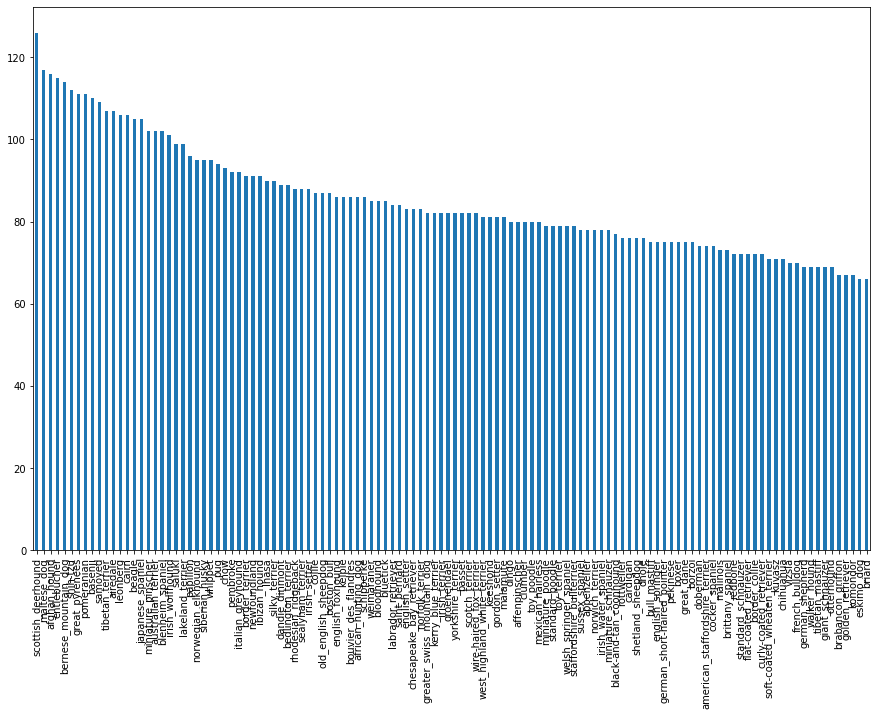

In [16]:
plt.figure(figsize=(15, 10))
train_labels['breed'].value_counts().plot(kind='bar')
plt.show()

In [17]:
#Create list of alphabetically sorted labels.
dog_breeds = sorted(list(set(train_labels['breed'])))
n_classes = len(dog_breeds)
print(n_classes)
dog_breeds[:3]

120


['affenpinscher', 'afghan_hound', 'african_hunting_dog']

In [18]:
#Map each label string to an integer label.
class_to_num = dict(zip(dog_breeds, range(n_classes)))

In [19]:
def images_to_array(data_dir, labels_dataframe, img_size = (224,224,3)):
    '''
    1- Read image samples from certain directory.
    2- Risize it, then stack them into one big numpy array.
    3- Read sample's label form the labels dataframe.
    4- One hot encode labels array.
    5- Shuffle Data and label arrays.
    '''
    images_names = labels_dataframe['id']
    images_labels = labels_dataframe['breed']
    data_size = len(images_names)
    #initailize output arrays.
    X = np.zeros([data_size, img_size[0], img_size[1], img_size[2]], dtype=np.uint8)
    y = np.zeros([data_size,1], dtype=np.uint8)
    #read data and lables.
    for i in tqdm(range(data_size)):
        image_name = images_names[i]
        img_dir = os.path.join(data_dir, image_name+'.jpg')
        img_pixels = load_img(img_dir, target_size=img_size)
        X[i] = img_pixels
        
        image_breed = images_labels[i]
        y[i] = class_to_num[image_breed]
    
    #One hot encoder
    y = to_categorical(y)
    #shuffle    
    ind = np.random.permutation(data_size)
    X = X[ind]
    y = y[ind]
    print('Ouptut Data Size: ', X.shape)
    print('Ouptut Label Size: ', y.shape)
    return X, y

In [20]:
img_size = (331,331,3)
try:
  X = np.load(FOLDER + "X_save.npy")
  y = np.load(FOLDER + "y_save.npy")
  print(len(X), len(y))
except: 
  #img_size chosen to be 331 to suit the used architectures.
  X, y = images_to_array(train_dir, train_labels, img_size)
  np.save(FOLDER + "X_save", X)
  np.save(FOLDER + "y_save", y)

10222 10222


In [21]:
def get_features(model_name, data_preprocessor, input_size, data):
    '''
    1- Create a feature extractor to extract features from the data.
    2- Returns the extracted features and the feature extractor.
    '''
    #Prepare pipeline.
    input_layer = Input(input_size)
    preprocessor = Lambda(data_preprocessor)(input_layer)
    base_model = model_name(weights='imagenet', include_top=False,
                            input_shape=input_size)(preprocessor)
    avg = GlobalAveragePooling2D()(base_model)
    feature_extractor = Model(inputs = input_layer, outputs = avg)
    print(feature_extractor)
    #Extract feature.
    feature_maps = feature_extractor.predict(data, batch_size=128, verbose=1)
    print('Feature maps shape: ', feature_maps.shape)
    return feature_maps

In [22]:
from keras.applications.inception_v3 import InceptionV3, preprocess_input
inception_preprocessor = preprocess_input

In [23]:
inceptionV3 = InceptionV3(weights='imagenet', include_top=False, input_shape=img_size)

87924736/87910968 [==============================] - 1s 0us/step


In [24]:
# train_X = X[:9000]
# train_y = y[:9000]
train_X = X
train_y = y
val_X = X[9000:]
val_y = y[9000:]
train_X.shape, val_X.shape

((10222, 331, 331, 3), (1222, 331, 331, 3))

In [25]:
del X

In [26]:
inceptionV3.layers[-1].output_shape[-1]

2048

In [27]:
# Extract features using InceptionV3 as extractor.
from keras.applications.inception_v3 import InceptionV3, preprocess_input
inception_preprocessor = preprocess_input
inception_features = get_features(InceptionV3,
                                  inception_preprocessor,
                                  img_size, train_X)

80/80 [==============================] - 34s 289ms/step
Feature maps shape:  (10222, 2048)


In [28]:
# Extract features using Xception as extractor.
from keras.applications.xception import Xception, preprocess_input
xception_preprocessor = preprocess_input
xception_features = get_features(Xception,
                                 xception_preprocessor,
                                 img_size, train_X)

80/80 [==============================] - 49s 588ms/step
Feature maps shape:  (10222, 2048)


In [29]:
# Extract features using NASNetLarge as extractor.
from keras.applications.nasnet import NASNetLarge, preprocess_input
nasnet_preprocessor = preprocess_input
nasnet_features = get_features(NASNetLarge,
                               nasnet_preprocessor,
                               img_size, train_X)

80/80 [==============================] - 173s 2s/step
Feature maps shape:  (10222, 4032)


In [30]:
# Extract features using InceptionResNetV2 as extractor.
from keras.applications.inception_resnet_v2 import InceptionResNetV2, preprocess_input
inc_resnet_preprocessor = preprocess_input
inc_resnet_features = get_features(InceptionResNetV2,
                                   inc_resnet_preprocessor,
                                   img_size, train_X)

80/80 [==============================] - 63s 726ms/step
Feature maps shape:  (10222, 1536)


In [31]:
final_features = np.concatenate([inception_features,
                                 xception_features,
                                 nasnet_features,
                                 inc_resnet_features,], axis=-1)
print('Final feature maps shape', final_features.shape)

Final feature maps shape (10222, 9664)


In [32]:
final_features.shape[1:]

(9664,)

In [33]:
final_features

array([[1.11539684e-01, 6.22103930e-01, 3.10530454e-01, ...,
        4.70965534e-01, 5.47226556e-02, 1.28184184e-01],
       [2.56768495e-01, 9.65756923e-02, 9.83254462e-02, ...,
        2.61455625e-01, 3.79104279e-02, 9.52652469e-03],
       [2.98992068e-01, 3.26059274e-02, 8.89449269e-02, ...,
        7.30606960e-04, 1.89481452e-02, 3.80175225e-02],
       ...,
       [2.13183865e-01, 1.44608110e-01, 1.79432377e-01, ...,
        5.82909167e-01, 2.91813305e-03, 1.73474625e-02],
       [2.25700304e-01, 3.32145959e-01, 1.54906616e-01, ...,
        0.00000000e+00, 9.08468012e-03, 1.81502923e-01],
       [1.50240883e-01, 4.84706722e-02, 3.92507538e-02, ...,
        1.02020061e+00, 5.40647190e-03, 1.89242400e-02]], dtype=float32)

In [34]:
from keras.callbacks import EarlyStopping
#Prepare call backs
EarlyStop_callback = keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
my_callback=[EarlyStop_callback]

In [35]:
#Prepare DNN model
dnn = keras.models.Sequential([
    InputLayer(final_features.shape[1:]),
    Dropout(0.8),
    Dense(n_classes, activation='softmax')
])

dnn.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

In [36]:
dnn.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dropout (Dropout)           (None, 9664)              0         
                                                                 
 dense (Dense)               (None, 120)               1159800   
                                                                 
Total params: 1,159,800
Trainable params: 1,159,800
Non-trainable params: 0
_________________________________________________________________


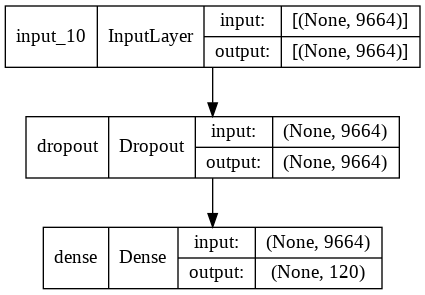

In [37]:
from tensorflow.keras.utils import plot_model
plot_model(dnn, to_file='model_shapes.png', show_shapes=True)

In [38]:
#Train simple DNN on extracted features.
h = dnn.fit(final_features, train_y,
            batch_size=128,
            epochs=100,
            validation_split=0.1,
            callbacks=my_callback)

Epoch 1/100
72/72 [==============================] - 1s 8ms/step - loss: 1.0876 - accuracy: 0.7824 - val_loss: 0.1933 - val_accuracy: 0.9286
Epoch 2/100
72/72 [==============================] - 0s 5ms/step - loss: 0.1949 - accuracy: 0.9413 - val_loss: 0.1866 - val_accuracy: 0.9384
Epoch 3/100
72/72 [==============================] - 0s 5ms/step - loss: 0.1581 - accuracy: 0.9500 - val_loss: 0.1897 - val_accuracy: 0.9394
Epoch 4/100
72/72 [==============================] - 0s 5ms/step - loss: 0.1364 - accuracy: 0.9560 - val_loss: 0.1965 - val_accuracy: 0.9365
Epoch 5/100
72/72 [==============================] - 0s 5ms/step - loss: 0.1243 - accuracy: 0.9596 - val_loss: 0.1923 - val_accuracy: 0.9355
Epoch 6/100
72/72 [==============================] - 0s 5ms/step - loss: 0.1069 - accuracy: 0.9664 - val_loss: 0.2084 - val_accuracy: 0.9345
Epoch 7/100
72/72 [==============================] - 0s 5ms/step - loss: 0.0934 - accuracy: 0.9686 - val_loss: 0.1911 - val_accuracy: 0.9374
Epoch 8/100
7

In [39]:

inception_features = get_features(InceptionV3,
                                  inception_preprocessor,
                                  img_size, val_X)
xception_features = get_features(Xception,
                                 xception_preprocessor,
                                 img_size, val_X)
nasnet_features = get_features(NASNetLarge,
                               nasnet_preprocessor,
                               img_size, val_X)
inc_resnet_features = get_features(InceptionResNetV2,
                                   inc_resnet_preprocessor,
                                   img_size, val_X)

10/10 [==============================] - 6s 401ms/step
Feature maps shape:  (1222, 2048)
10/10 [==============================] - 7s 686ms/step
Feature maps shape:  (1222, 2048)
10/10 [==============================] - 26s 2s/step
Feature maps shape:  (1222, 4032)
10/10 [==============================] - 11s 819ms/step
Feature maps shape:  (1222, 1536)


In [40]:
def get_final_feature(X):
  inception_features = get_features(InceptionV3,
                                  inception_preprocessor,
                                  img_size, X)
  xception_features = get_features(Xception,
                                  xception_preprocessor,
                                  img_size, X)
  nasnet_features = get_features(NASNetLarge,
                                nasnet_preprocessor,
                                img_size, X)
  inc_resnet_features = get_features(InceptionResNetV2,
                                    inc_resnet_preprocessor,
                                    img_size, X)
  return np.concatenate([inception_features,
                                 xception_features,
                                 nasnet_features,
                                 inc_resnet_features,], axis=-1)

In [41]:
final_features_val = np.concatenate([inception_features,
                                 xception_features,
                                 nasnet_features,
                                 inc_resnet_features,], axis=-1)

In [42]:
pred_y = dnn.predict(final_features_val, batch_size=128)

In [43]:
val_y.shape

(1222, 120)

In [44]:
def precision(pred, answer):
  total = len(answer)
  fail = 0
  if len(pred) != len(answer):
    raise Exception
  for i in range(total):
    if np.argmax(pred[i]) != np.argmax(answer[i]):
      fail += 1
  return 1 - fail / total

In [45]:
precision(pred_y, val_y)

0.9378068739770867

In [58]:
from os import listdir
def find_all_images(dname):
  return sorted([fname for fname in listdir(dname) if '.jpg' or '.png' in fname])

In [47]:
NUM_TO_CLASS = dict()
for k, v in class_to_num.items():
  NUM_TO_CLASS[v] = k

In [48]:
dname = FOLDER + "/real/"
image_names = find_all_images(dname)
data_size = len(image_names)
X_real = np.zeros([data_size, img_size[0], img_size[1], img_size[2]], dtype=np.uint8)
print("total images: ", data_size)
#read data and lables.
for i, fname in enumerate(image_names):
    image_name = dname + fname
    img_pixels = load_img(image_name, target_size=img_size)
    X_real[i] = img_pixels

total images:  47


In [49]:
X_real.shape

(47, 331, 331, 3)

In [50]:
final_feature_real = get_final_feature(X_real)

1/1 [==============================] - 2s 2s/step
Feature maps shape:  (47, 2048)
1/1 [==============================] - 2s 2s/step
Feature maps shape:  (47, 2048)
1/1 [==============================] - 7s 7s/step
Feature maps shape:  (47, 4032)
1/1 [==============================] - 4s 4s/step
Feature maps shape:  (47, 1536)


In [51]:
y_real = dnn.predict(final_feature_real, batch_size=128)

In [52]:
def change_to_classname(y):
  res = []
  for i in y:
    idx = np.argmax(i)
    res_class = NUM_TO_CLASS[idx]
    prob = i[idx]
    res.append((res_class, prob))
  return res

In [73]:
def get_result(y):
  res = []
  for i in y:
    idx = np.argmax(i)
    idx2 = np.argsort(i)[-2]
    res_class1 = NUM_TO_CLASS[idx]
    res_class2 = NUM_TO_CLASS[idx2]
    prob1 = i[idx]
    prob2 = i[idx2]
    res.append([(res_class1, prob1), (res_class2, prob2)])
  return res

In [53]:
res = change_to_classname(y_real)

In [54]:
# fig = plt.figure() # rows*cols 행렬의 i번째 subplot 생성
# rows = 2
# cols = 2
# i = 1
 
# xlabels = ["xlabel", "(a)", "(b)", "(c)", "(d)"]
 
# for filename in glob.glob("*.jpg"):
#     img = cv2.imread(filename)
#     ax = fig.add_subplot(rows, cols, i)
#     ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
#     ax.set_xlabel(xlabels[i])
#     ax.set_xticks([]), ax.set_yticks([])
#     i += 1
 
# plt.show()

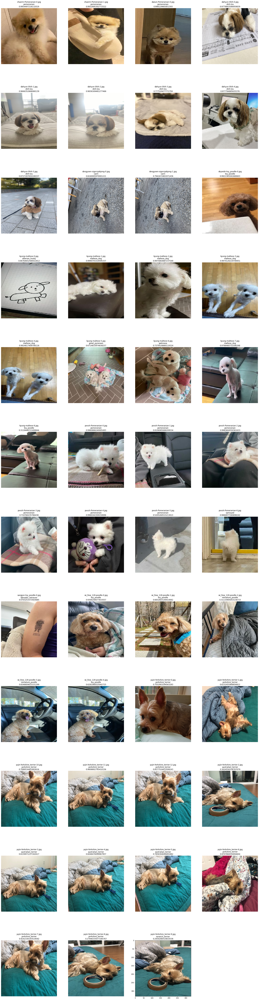

In [55]:
%matplotlib inline
from PIL import Image

plt.figure(figsize=(30, 120))
columns = 4
image_size = len(image_names)
# enumerate(zip(X_real, image_names, res))
for i in range(image_size):
    pil_image = Image.fromarray(X_real[i])
    plt.axis("off") # 축 제거
    plt.subplot(image_size / columns + 1, columns, i + 1)
    plt.title(f"{image_names[i]}\n{res[i][0]}\n{res[i][1]}") # 제목 추가
    plt.imshow(pil_image)

In [60]:
dname = FOLDER + "/naive_mix/"
image_names = find_all_images(dname)
data_size = len(image_names)
X_navie_mix = np.zeros([data_size, img_size[0], img_size[1], img_size[2]], dtype=np.uint8)
print("total images: ", data_size)
#read data and lables.
for i, fname in enumerate(image_names):
    image_name = dname + fname
    img_pixels = load_img(image_name, target_size=img_size)
    X_navie_mix[i] = img_pixels

total images:  36


In [61]:
final_feature_navie_mix = get_final_feature(X_navie_mix)
y_naive = dnn.predict(final_feature_navie_mix, batch_size=128)

1/1 [==============================] - 2s 2s/step
Feature maps shape:  (36, 2048)
1/1 [==============================] - 1s 1s/step
Feature maps shape:  (36, 2048)
1/1 [==============================] - 7s 7s/step
Feature maps shape:  (36, 4032)
1/1 [==============================] - 4s 4s/step
Feature maps shape:  (36, 1536)


In [66]:
res = get_result(y_naive)

In [80]:
def get_result_set(path):
  dname = FOLDER + path
  image_names = find_all_images(dname)
  data_size = len(image_names)
  X_navie_mix = np.zeros([data_size, img_size[0], img_size[1], img_size[2]], dtype=np.uint8)
  print("total images: ", data_size)
  #read data and lables.
  for i, fname in enumerate(image_names):
      image_name = dname + fname
      try:
        img_pixels = load_img(image_name, target_size=img_size)
      except:
        print(image_name)
        continue
      X_navie_mix[i] = img_pixels
  final_feature_navie_mix = get_final_feature(X_navie_mix)
  y_naive = dnn.predict(final_feature_navie_mix, batch_size=128)
  res = get_result(y_naive)
  return X_navie_mix, image_names, res

In [75]:
def draw_picture(X, images_name, res):
  plt.figure(figsize=(30, 120))
  columns = 4
  image_size = len(image_names)
  # enumerate(zip(X_real, image_names, res))
  for i in range(image_size):
      pil_image = Image.fromarray(X[i])
      plt.axis("off") # 축 제거
      plt.subplot(image_size / columns + 1, columns, i + 1)
      plt.title(f"{image_names[i]}\n{res[i][0][0]}: {res[i][0][1]}\n {res[i][1][0]}: {res[i][1][1]}") # 제목 추가
      plt.imshow(pil_image)

In [76]:
X, images_name, res = get_result_set("/naive_mix/")

total images:  36
1/1 [==============================] - 1s 1s/step
Feature maps shape:  (36, 2048)
1/1 [==============================] - 1s 810ms/step
Feature maps shape:  (36, 2048)
1/1 [==============================] - 6s 6s/step
Feature maps shape:  (36, 4032)
1/1 [==============================] - 4s 4s/step
Feature maps shape:  (36, 1536)


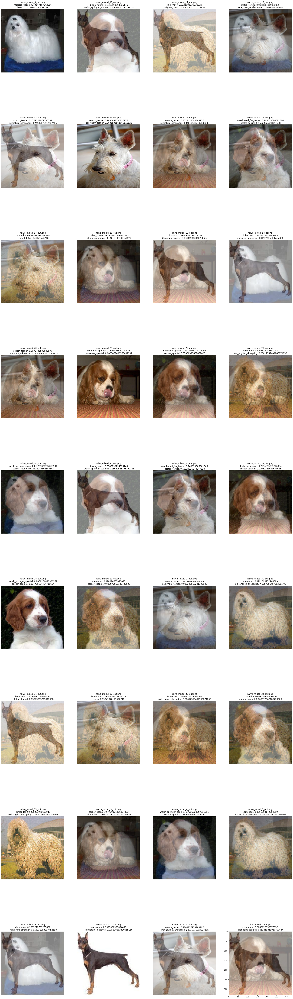

In [77]:
draw_picture(X, images_name, res)

In [81]:
X, images_name, res = get_result_set("/feature_mix/")

total images:  18
1/1 [==============================] - 2s 2s/step
Feature maps shape:  (18, 2048)
1/1 [==============================] - 1s 1s/step
Feature maps shape:  (18, 2048)
1/1 [==============================] - 6s 6s/step
Feature maps shape:  (18, 4032)
1/1 [==============================] - 4s 4s/step
Feature maps shape:  (18, 1536)


IndexError: ignored

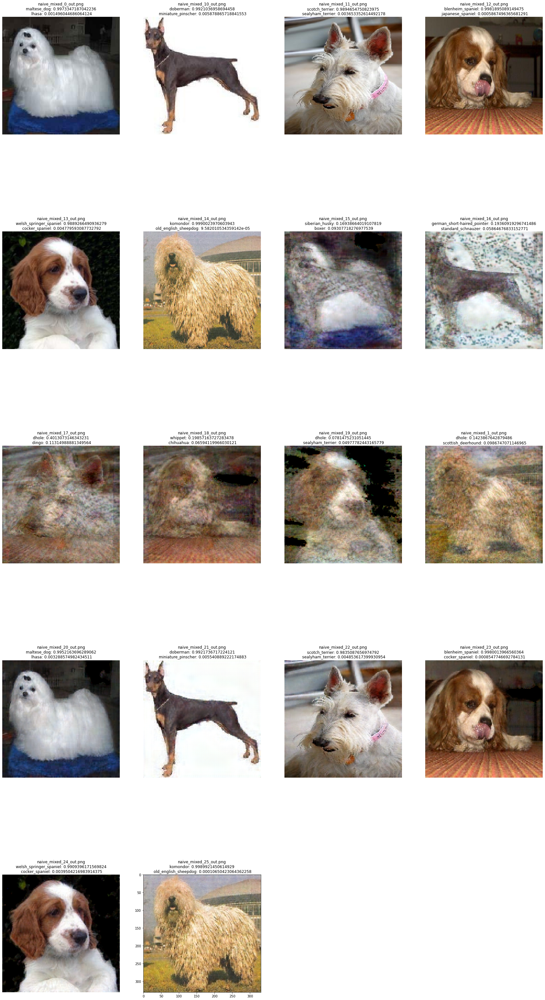

In [83]:
draw_picture(X, images_name, res)

In [ ]:
from typing import List

class DogBreedClassification():
  def __init__(self, model_list, processor_list, input_size):
    self.model_and_processor = zip(model_list, processor_list)
    self.input_size = input_size
    print("image_size: ", self.input_size)
    self.model_list = self._initiate_model()
    self.dnn = self._make_dnn_model()
    print(self.dnn.summary())

  def _get_input_shape(self) -> int:
    input_layer_size = 0
    for model in self.model_list:
      input_layer_size += model.layers[-1].output_shape[-1]
    return input_layer_size

  def _initiate_model(self) -> List[object]:
    model_list = []
    for model_name, data_preprocessor in self.model_and_processor:
      input_layer = Input(self.input_size)
      preprocessor = Lambda(data_preprocessor)(input_layer)
      base_model = model_name(weights='imagenet', include_top=False, input_shape=self.input_size)(preprocessor)
      avg = GlobalAveragePooling2D()(base_model)
      feature_extractor = Model(inputs = input_layer, outputs = avg)
      model_list.append(feature_extractor)
    return model_list

  def extract_features(self, data):
    feature_list = []
    for model in self.model_list:
      print(model)
      feature_list.append(model.predict(data, batch_size=128, verbose=1))
    final_features = np.concatenate(feature_list, axis=-1)
    return final_features

  def _make_dnn_model(self):
    input_layer_shape = self._get_input_shape()
    dnn = keras.models.Sequential([
      InputLayer((input_layer_shape,)),
      Dropout(0.7),
      Dense(n_classes, activation='softmax')
      ])
    dnn.compile(optimizer='adam',
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])
    return dnn
  
  def training_dnn_model(self, X, y):
    final_features = self.extract_features(X)
    dnn.fit(final_features, y,
            batch_size=128,
            epochs=60,
            validation_split=0.1,
            callbacks=my_callback)
    
  def predict(self, X):
    final_features = self.extract_features(X)
    y_pred = dnn.predict(final_features, batch_size=128)
    return y_pred

In [ ]:
from keras.applications.inception_resnet_v2 import InceptionResNetV2, preprocess_input as InceptionResNetV2_p
from keras.applications.nasnet import NASNetLarge, preprocess_input as NASNetLarge_p
from keras.applications.xception import Xception, preprocess_input as Xception_p
from keras.applications.inception_v3 import InceptionV3, preprocess_input as InceptionV3_p

model_list = [InceptionResNetV2, NASNetLarge, Xception, InceptionV3]
processor_list = [InceptionResNetV2_p, NASNetLarge_p, Xception_p, InceptionV3_p]
img_size = (331,331,3)

In [ ]:
dog_classifier = DogBreedClassification(model_list=model_list, processor_list=processor_list, input_size=img_size)

image_size:  (331, 331, 3)
87924736/87910968 [==============================] - 1s 0us/step
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dropout (Dropout)           (None, 9664)              0         
                                                                 
 dense (Dense)               (None, 120)               1159800   
                                                                 
Total params: 1,159,800
Trainable params: 1,159,800
Non-trainable params: 0
_________________________________________________________________
None


In [ ]:
train_X = X[:9000]
train_y = y[:9000]
val_X = X[9000:]
val_y = y[9000:]
train_X.shape, val_X.shape

NameError: ignored

In [ ]:
del y

In [ ]:
dog_classifier.training_dnn_model(train_X, train_y)

71/71 [==============================] - 50s 717ms/step


ResourceExhaustedError: ignored

In [ ]:
pip3

absl-py==0.12.0
alabaster==0.7.12
albumentations==0.1.12
altair==4.1.0
appdirs==1.4.4
argcomplete==1.12.3
argon2-cffi==21.1.0
arviz==0.11.4
astor==0.8.1
astropy==4.3.1
astunparse==1.6.3
atari-py==0.2.9
atomicwrites==1.4.0
attrs==21.2.0
audioread==2.1.9
autograd==1.3
Babel==2.9.1
backcall==0.2.0
beautifulsoup4==4.6.3
bleach==4.1.0
blis==0.4.1
bokeh==2.3.3
Bottleneck==1.3.2
branca==0.4.2
bs4==0.0.1
CacheControl==0.12.10
cached-property==1.5.2
cachetools==4.2.4
catalogue==1.0.0
certifi==2021.10.8
cffi==1.15.0
cftime==1.5.1.1
chardet==3.0.4
charset-normalizer==2.0.7
click==7.1.2
cloudpickle==1.3.0
cmake==3.12.0
cmdstanpy==0.9.5
colorcet==2.0.6
colorlover==0.3.0
community==1.0.0b1
contextlib2==0.5.5
convertdate==2.3.2
coverage==3.7.1
coveralls==0.5
crcmod==1.7
cufflinks==0.17.3
cupy-cuda111==9.4.0
cvxopt==1.2.7
cvxpy==1.0.31
cycler==0.11.0
cymem==2.0.6
Cython==0.29.24
daft==0.0.4
dask==2.12.0
datascience==0.10.6
debugpy==1.0.0
decorator==4.4.2
defusedxml==0.7.1
descartes==1.1.0
dill==0.3.4
